In [3]:
import aeifdataset as ad
from aeifdataset import Dataloader, DataRecord
from pprint import pprint  # For structured output

In [8]:
data_path = '../data/'

# Access the whole dataset
# The Dataloader class loads and manages multiple .4mse files from the specified directory.
dataset = Dataloader(data_path)

# Access a single Data Record
# Each DataRecord corresponds to a file, which contains multiple frames.
example_record_1 = dataset[0]
# Alternatively; access by name:
example_record_1 = DataRecord(data_path+"example_record_1.4mse")

# Access a single frame
# A frame contains sensor data and metadata for a 100ms period.
example_frame = example_record_1[0]

# Iterate through Data Records and Frames
frames = []
for datarecord in dataset:
    for frame in datarecord:
        frames.append(frame)

# Access the third frame in the dataset
# This frame will be used as an example to demonstrate data access.
frame = frames[2]
print('Frame Metadata:')
pprint(vars(frame))  # Using pprint for a more readable output


Frame Metadata:
{'frame_id': 1016,
 'timestamp': Decimal('1727426142799683960'),
 'tower': <aeifdataset.data.agent.Tower object at 0x1687facd0>,
 'vehicle': <aeifdataset.data.agent.Vehicle object at 0x1686c3bd0>,
 'version': '0.7.5'}


In [10]:
# Access vehicle metadata
vehicle_metadata = frame.vehicle.info

# Access vehicle camera "STEREO_LEFT" rectified image
stereo_left_image = frame.vehicle.cameras.STEREO_LEFT

# Access tower camera "VIEW_1" raw image with corresponding metadata
view_1_raw_image = frame.tower.cameras.VIEW_1._image_raw
view_1_metadata = frame.tower.cameras.VIEW_1.info

# Access tower "UPPER_PLATFORM" lidar points and timestamp of the pointcloud
upper_platform_lidar_points = frame.tower.lidars.UPPER_PLATFORM
upper_platform_lidar_timestamp = frame.tower.lidars.UPPER_PLATFORM.timestamp

# Access vehicle IMU data
imu_data = frame.vehicle.IMU

# Access tower GNSS data
tower_gnss_data = frame.tower.GNSS

# Access dynamics velocity and metadata
dynamics_velocity = frame.vehicle.DYNAMICS.velocity
dynamics_info = frame.vehicle.DYNAMICS.info

# The data can be printed to view key information contained in the object.
# For a comprehensive list of all available fields, refer to the documentation.
print(view_1_metadata)

CameraInformation(
    name=view_1,
    model_name=a2A1920-51gcPRO,
    camera_mtx=
    [[1.750e+03, 0.000e+00, 9.273e+02],
     [0.000e+00, 1.750e+03, 5.667e+02],
     [0.000e+00, 0.000e+00, 1.000e+00]],
    distortion_mtx=
    [-2.578e-01,  1.063e-01,  1.686e-04,  4.817e-04,  0.000e+00],
    extrinsic=Pose(
        xyz=[ 0.297,  0.22 , -0.54 ],
        rpy=[-1.799,  0.05 , -1.168]
    )
)


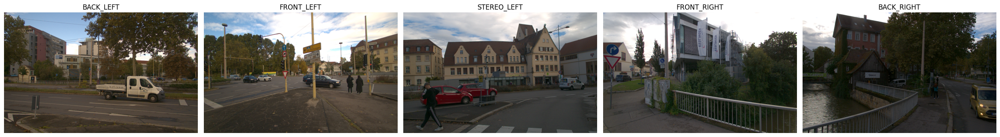

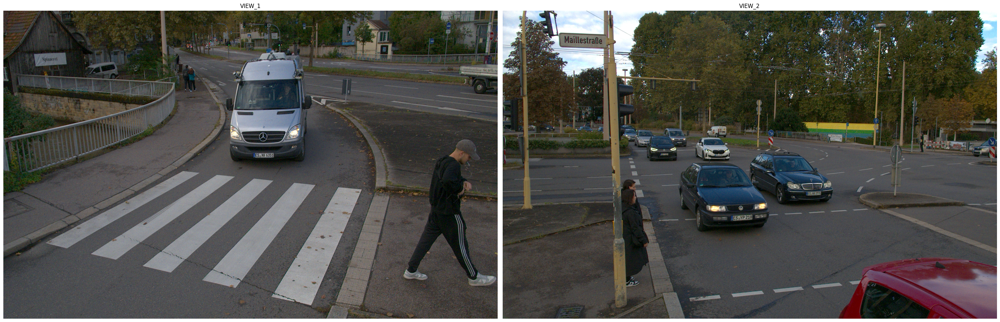

In [11]:
import matplotlib.pyplot as plt

# Iterate over agents in the frame (vehicle and tower)
# Each agent contains its own set of cameras. We'll visualize all the camera images.
for agent in frame:
    cameras = agent.cameras
    num_cameras = len(cameras)

    # Create a figure to display the camera images
    plt.figure(figsize=(30, 10))

    # Iterate over the cameras of the current agent
    for i, (camera_name, camera) in enumerate(cameras):
        #setting up subplots for displaying images
        plt.subplot(1, num_cameras, i + 1)

        # Access and display the image captured by the camera
        plt.imshow(camera)
        plt.title(camera_name)
        plt.axis('off')

    # Display the images for the current agent
    plt.tight_layout()
    plt.show()

In [12]:
# A single Image can be accessed and visualised through predefined
# plt.imshow(stereo_left_image) or
# plt.imshow(frame.vehicle.cameras.STEREO_LEFT)

# Outside of Jupyter Notebooks images can also be visualized by simply calling:
# stereo_left_image.show()

In [13]:
import plotly.graph_objects as go
import numpy as np

# Convert structured NumPy array to a regular 3D NumPy array with contiguous memory.
xyz_points = np.stack((upper_platform_lidar_points['x'], upper_platform_lidar_points['y'], upper_platform_lidar_points['z']), axis=-1)

def visualize_lidar_points(points, points_color=None, title="LiDAR Point Cloud", size=2, opacity=0.6):
    '''
    This function provides utility to visualize a pointcloud in jupyter notebooks. Outside of Jupyter Notebooks lidar pointclouds can also be visualized by simply calling:
    ad.show_points(upper_platform_lidar_points)
    '''
    if points_color is None:
        color = points[:, 2]
        marker_color = dict(
            size=size,
            color=color,
            colorscale='viridis',
            opacity=opacity
        )
    else:
        #this will be used later in the colab
        marker_color = dict(
            size=size,
            color=['rgb({}, {}, {})'.format(*rgb) for rgb in points_color],
            opacity=opacity
        )

    # Create a plotly 3D scatter plot
    fig = go.Figure(data=[go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=marker_color
    )])

    # Update the layout for better visualization
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            aspectmode='data'
        ),
        width=800,
        height=700,
        title=title
    )

    fig.show()

visualize_lidar_points(xyz_points, title='Upper Platform LiDAR Point Cloud')

In [14]:
# Minimal Example to demonstrate iterative processing of the lidar data
for lidar_name, lidar in frame.vehicle.lidars:
    print(f'Data from vehicle {lidar_name} LiDAR')

for lidar_name, lidar in frame.tower.lidars:
    print(f'Data from tower {lidar_name} LiDAR')

Data from vehicle LEFT LiDAR
Data from vehicle TOP LiDAR
Data from vehicle RIGHT LiDAR
Data from tower VIEW_1 LiDAR
Data from tower VIEW_2 LiDAR
Data from tower UPPER_PLATFORM LiDAR
